# Test SOM

In [1]:
import os
print os.getcwd() 

import sys
print sys.path
sys.path.append('C:/Python27/Lib')
sys.path.append('C:/Python27/Lib/site-packages')

C:\Users\thsch\Desktop\Bachelor_Thesis_2017_Sources\Notebook\Tests
['', 'C:\\ProgramData\\Anaconda2\\python27.zip', 'C:\\ProgramData\\Anaconda2\\DLLs', 'C:\\ProgramData\\Anaconda2\\lib', 'C:\\ProgramData\\Anaconda2\\lib\\plat-win', 'C:\\ProgramData\\Anaconda2\\lib\\lib-tk', 'C:\\ProgramData\\Anaconda2', 'C:\\Users\\thsch\\AppData\\Roaming\\Python\\Python27\\site-packages', 'C:\\ProgramData\\Anaconda2\\lib\\site-packages', 'C:\\ProgramData\\Anaconda2\\lib\\site-packages\\Sphinx-1.5.1-py2.7.egg', 'C:\\ProgramData\\Anaconda2\\lib\\site-packages\\win32', 'C:\\ProgramData\\Anaconda2\\lib\\site-packages\\win32\\lib', 'C:\\ProgramData\\Anaconda2\\lib\\site-packages\\Pythonwin', 'C:\\ProgramData\\Anaconda2\\lib\\site-packages\\setuptools-27.2.0-py2.7.egg', 'C:\\ProgramData\\Anaconda2\\lib\\site-packages\\IPython\\extensions', 'C:\\Users\\thsch\\.ipython']


In [20]:
import KohonenUtils
import numpy as np
import pandas as pd
import matplotlib.pyplot as pl
from matplotlib import cm
import matplotlib.patches as mpatches
import math
%matplotlib inline

'''animals = pd.DataFrame(columns=['small', 'medium', 'big', '2legs', '4legs', 'hair', 'hooves',
                                'mane', 'feathers', 'hunt', 'run', 'fly', 'swim'])

matrix = np.array([[1,0,0,1,0,0,0,0,1,0,0,1,0],
                   [1,0,0,1,0,0,0,0,1,0,0,0,0],
                   [1,0,0,1,0,0,0,0,1,0,0,0,1],
                   [1,0,0,1,0,0,0,1,1,0,0,1,1],
                   [1,0,0,1,0,0,0,0,1,1,0,1,0],
                   [1,0,0,1,0,0,0,0,1,1,0,1,0],
                   [0,1,0,1,0,0,0,0,1,1,0,1,0],
                   [0,1,0,0,1,1,0,0,0,1,0,0,0],
                   [0,1,0,0,1,1,0,0,0,0,1,0,0],
                   [0,1,0,0,1,1,0,1,0,1,1,0,0],
                   [1,0,0,0,1,1,0,0,0,1,0,0,0],
                   [0,0,1,0,1,1,0,0,0,1,1,0,0],
                   [0,0,1,0,1,1,0,1,0,1,1,0,0],
                   [0,0,1,0,1,1,1,1,0,0,1,0,0],
                   [0,0,1,0,1,1,1,1,0,0,1,0,0],
                   [0,0,1,0,1,1,1,0,0,0,0,0,0]])

for i, row in enumerate(matrix):
    animals.loc[i] = row

animals.index = ['dove', 'hen', 'duck', 'goose', 'owl', 'hawk', 'eagle', 'fox',
                 'dog', 'wolf', 'cat', 'tiger', 'lion', 'horse', 'zebra', 'cow']

pl.figure(figsize=(5,5))
pl.xticks(np.arange(matrix.shape[1]), animals.columns, rotation=90)
pl.yticks(np.arange(matrix.shape[0]), animals.index)
pl.title('Animals')
_ = pl.imshow(matrix, interpolation='nearest', cmap=cm.binary)'''

df = pd.read_csv('../DataAnalysis/data/DataRisaralda_v2_utf-8.csv', header=0, sep=',', index_col=0, parse_dates=False, encoding='utf-8')


# réduire le dataset uniquement aux données numériques

cols = ['Negros y vinagres','Broca','Broca de punto','Veteado',
         'Inmaduro','Flojo','Sobresecado','Arrugado','Aplastado','Cristalizado','Reposado','Granizo',
         'Partido','Defectos totales','Humedad (%)','Merma (%)','Aroma-Fragancia',
         'Acidez','Cuerpo','Sabor',
         'Sabor residual','Dulzor','Uniformidad','Balance','Taza limpia','Puntaje catador','Puntaje Total',
         'prec1','prec2','prec3','prec4','prec5','prec6','prec7','prec8','prec9','prec10','tmin1','tmin2','tmin3','tmin4','tmin5',
         'tmin6','tmin7','tmin8','tmin9','tmin10','tmax1','tmax2','tmax3','tmax4','tmax5','tmax6','tmax7','tmax8','tmax9','tmax10',
         'tmean1','tmean2','tmean3','tmean4','tmean5','tmean6','tmean7','tmean8','tmean9','tmean10','dtr1','dtr2','dtr3','dtr4',
         'dtr5','dtr6','dtr7','dtr8','dtr9','dtr10','franco_L1','arcilloso_L1','limoso_L1','arenoso_L1','cascajoso_L1','franco_L2',
        'arcilloso_L2','limoso_L2','arenoso_L2','cascajoso_L2','franco_L3','arcilloso_L3','limoso_L3','arenoso_L3','cascajoso_L3',
        'pH_avg','org_avg','SICA 1','year']




outputData = cols[0-26]
inputData = cols[27:]

df = df[cols]

This is the features on which we will run our SOM algorithm in order to find an inherent data structure, or similarities between samples.

### Definition of the problem

In this problem, we will apply the SOM algorithm as follows:
    
1. Initialize SOM with its parameters (such as size of the map, neighborood size, learning rate...)
2. Sequentially present a random sample animal for the map to learn
3. Repeat step 2 until the whole dataset was learned t times

After the SOM has been "trained", we can then visualize it by plotting its U-Matrix (also known as Unified Distance Matrix) which shows the neurons and the distance with their neighbors.
To construct a U-Matrix, we need to:

1. Create a cell for each neuron
2. Create a cell for each 1-1 connection between two neurons
3. Assign these new cells the distance between the two neurons they connect (higher is further apart)

In the end, if we have a very simple SOM (2x2):

    Neuron(0) - Neuron(1)
       |           |
    Neuron(2) - Neuron(4)

The corresponding U-Matrix (2\*2 -1=3, 2\*2 -1=3) will be:

    Neuron(0) - Dist(0,1) - Neuron(1)
       |           |           |
    Dist(0,2) -  ?????    - Dist(1,3)
       |           |           |
    Neuron(2) - Dist(2,3) - Neuron(3)
    

We are only going to plot the distances.

Let us present the animal dataset 10 times to a newly generated kohonen map. We can then compute its U-matrix and plot the result.

### First tests with SOM and U-Matrix

In [13]:
df.shape

(767, 79)

In [23]:
kmap = KohonenUtils.KohonenMap(50,
                               50,
                               size_vector=len(df.columns))
n_iter = 5
learning_rate = KohonenUtils.ExponentialTimeseries(1, 0.2, n_iter * len(df.index))
neighborhood_size = KohonenUtils.ExponentialTimeseries(4./3 * len(df.index), 1, n_iter * len(df.index))

kmap.train(df.as_matrix(), np.array(df[outputData]), n_iter, learning_rate, neighborhood_size)

kmap.plot_umatrix(plot_names=True, plot_empty=True,figsize=(200,200), fontsize=80, color_classes=True)

## Exercise 2 : Benchmark Datasets

### Dataset information

In this exercise, we will work with the FCPS benchmark published by A. Ultsch in his paper **"Clustering With SOM"**. FCPS stands for Fundamental Clustering Problems Suite, which is essentially 10 different datasets each having a main problem to adress. As you can find in the README associated with this benchmark, the data sets and main problems adressed are:

| data set      |   main problems of the set                          |   3d
|---            |---                                                  |   
| Hepta         |   none, i.e clear defined clusters                  |   **yes**
| Lsun          |   different variances and inter cluster distances   |   no
| Tetra         |   almost touching clusters                          |   **yes**
| Chainlink     |   linear not separable                              |   **yes**
| Atom          |   different variances and linear not separable      |   **yes**
| EngyTime      |   gaussian mixture                                  |   no
| Target        |   outlier                                           |   no
| TwoDiamonds   |   cluster border defined by density                 |   no
| WingNut       |   density vs. distance                              |   no
| GolfBall      |   no cluster at all                                 |   **yes**

The following script is designed to work with 3d datasets.

### Dataset visualization

### Clustering with SOM

In [17]:
kmap = KohonenUtils.KohonenMap(side_rows=int(math.sqrt(len(df.index))),
                               side_cols=int(math.sqrt(len(df.index)) * 2),
                               size_vector=len(df.columns)-1)
n_iter = 6
learning_rate = KohonenUtils.ExponentialTimeseries(1, 0.2, n_iter * len(df.index))
neighborhood_size = KohonenUtils.ExponentialTimeseries(4./3 * len(df.index), 1, n_iter * len(df.index))

kmap.train(df.as_matrix()[:,:-1], np.array(df.year), n_iter, learning_rate, neighborhood_size)



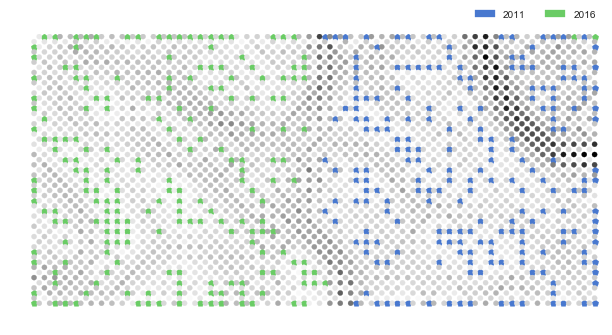

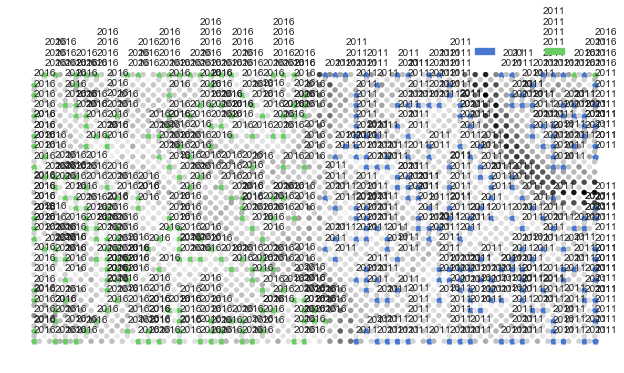

In [19]:
kmap.plot_umatrix(color_classes=True)
kmap.plot_umatrix(plot_names=True, fontsize=10, color_classes=True)

**Note:** the class labels are used only to visualize the results of our clustering method. They are NOT used to train our model as an error signal.

<p style="background-color:#660066; color:#fff;padding:5px; font-weight:bold">Q: Which of these five different 3d datasets are clustered correctly by Self-Organizing Map algorithm ? (to try with other datasets, you just have to change the dataset_name variable value and re-run the cells) </p>

<p style="background-color:#660066; color:#fff;padding:5px; font-weight:bold">Q: Which of these five different 3d datasets would K-Means correctly (or incorrectly) cluster ? Explain briefly why... </p>

## Exercise 3 : Text mining

### Dataset information

In this exercise, we will work with an open dataset of recipes. It is available at [OpenRecipes](https://github.com/fictivekin/openrecipes) as a database dump, which is already included in the zip file you downloaded.

This dataset is a json file, with records looking like:

    { "_id" : { "$oid" : "5160757796cc6207aada3230" }, "totalTime" : "PT30M", "description" : "These muffins are inspired by a new favorite snack of mine: A handful of roasted pistachios and chocolate chips. I really love the flavo", "ingredients" : "1½ cups whole wheat pastry flour\n1¾ cup roasted and unsalted shelled pistachios\n1 teaspoon baking powder\n1 teaspoon baking soda\n½ teaspoon sea salt\n¾ cup milk\n2 eggs\n½ cup coconut oil, walnut oil, or melted butter\n½ cup honey\n1½ cup chocolate chips", "url" : "http://naturallyella.com/2013/03/20/pistachio-and-chocolate-chip-muffins/", "image" : "http://cdn.naturallyella.com/files/2013/03/IMG_6411-2-200x300.jpg", "creator" : "Erin Alderson", "ts" : { "$date" : 1365276023004 }, "datePublished" : "2013-03-20T07:42:13+00:00", "source" : "naturallyella", "recipeYield" : "12", "cookTime" : "PT20M", "recipeCategory" : "Snack", "prepTime" : "PT10M", "name" : "Pistachio Chocolate Chip Muffins" }

With this dataset, we will first create features based on the ingredients of each recipe and then train a Kohonen map on these features. What we hope to discover is insights on a hidden structure... but first, we need to preprocess the data in order to make it easier to interpret. Note that this preprocessing is on Text Data. We call this domain "Text Mining". In order to continue, we use a corpora named "wordnet" which you can read about here: http://www.nltk.org/book/ch02.html#wordnet

To download this corpus, you will need the nltk (Natural Language Toolkit) package (generally included in anaconda installation). You should then open a python console, and run the following:

> import nltk; nltk.download()

This will open a window for you to download NLTK data. You can then either select the wordnet corpus under the "Corpora" tab, or download everything if you prefer (you can then create your own Text Mining applications).

After that, you should be able to run the TextMining.py main function, either from the terminal:

    $ ./TextMining.py
    
    There are 500 occurences of the word "fish" (50.0%)
    There are 500 occurences of the word "chocolate" (50.0%)
    There are 1000 recipes, and therefore 0.0% redundancy between words.

... or from the next cell:

In [ ]:
from TextMining import main

filter_words = ['fish', 'chocolate']

main(filter_words=filter_words)

In [ ]:

filter_words = ['fish', 'egg']

main(filter_words=filter_words)

By default, there are 1000 recipes considered, and we only filter recipes containing "fish" and "chocolate" in their title. Of course you can change that by modifying the python code. At the end, two files are generated:
- "Recipes.pkl" which contains recipes names and ingredients
- "Features_Exercise3.npy" which contains the TF-IDF (https://en.wikipedia.org/wiki/Tf%E2%80%93idf) vector of all ingredients for each recipe

### Dataset visualization

In [ ]:
from math import sqrt
from pandas.io.pickle import read_pickle

matrix = np.load('features_exercise3.npy')

recipes = read_pickle('recipes.pkl')
recipes.head(2)

As we said before, each line of these recipes "belongs" to a filter word.

Let us link back these filter words to each line:

In [ ]:
# Let us add the "class" back into the recipes dataset
corresponding_filter_words = []
for recipe_id in range(len(recipes.index)):
    temp_corresponding_filter_words = []
    for filter_word in filter_words:
        if filter_word in recipes.iloc[recipe_id].Name:
            temp_corresponding_filter_words.append(filter_word)
            continue
    if len(temp_corresponding_filter_words) == 1:
        filter_word = temp_corresponding_filter_words[0]
    else:
        filter_word = ' '.join(temp_corresponding_filter_words)
    corresponding_filter_words.append(filter_word)
recipes['Filter'] = corresponding_filter_words
recipes.head(2)

In [ ]:
print matrix.shape

Note that we have:
1. the "recipes" variable which is a pandas DataFrame, with each line being a recipe metadatas
2. the "matrix" variable which is a numpy array, with each line being the computed TF-IDF of a recipe

The matrix therefore contains the features.

### Clustering with SOM

We can then train our Kohononen map on these features.

Note that (as there are a lot of features ---every unique ingredient over all recipes--- the cosine metric is preferred to euclidean metric):

In [ ]:
################################################
### CAREFUL: THIS CELL IS PRETTY LONG TO RUN ###
################################################

# As we are dealing with TF-IDF values, therefore a lot of columns (features), the euclidean metric won't work well
# We can work with the cosine_metric instead https://en.wikipedia.org/wiki/Cosine_similarity
kmap = KohonenUtils.KohonenMap(side_rows=int(math.sqrt(matrix.shape[0]) * 2),
                               side_cols=int(math.sqrt(matrix.shape[0])),
                               size_vector=matrix.shape[1],
                               metric_name='cosine_metric')

n_iter = 3
learning_rate = KohonenUtils.ExponentialTimeseries(1, 0.05, n_iter*matrix.shape[0])
neighborhood_size = KohonenUtils.ExponentialTimeseries(2./3 * kmap._map.shape[0], 1, n_iter*matrix.shape[0])

kmap.train(matrix, np.array(recipes.Filter), n_iter, learning_rate, neighborhood_size)

In [ ]:
kmap.plot_umatrix(color_classes=True, plot_index=True, figsize=(10, 20))

<p style="background-color:#660066; color:#fff;padding:5px; font-weight:bold">Q: Comment the clustering obtained. Is it perfect ? Explain why you think that... If not, how could it be enhanced ?</p>

<p style="background-color:#660066; color:#fff;padding:5px; font-weight:bold">Q: Try different filter words than "chocolate" and "fish" (In order to do this, you either have to call the "main" function as seen a few cells before, or to modify the python code in the TextMining.py file)</p>

<p style="background-color:#660066; color:#fff;padding:5px; font-weight:bold">Q: In the class WordAccepter located in the TextMining.py file, we filter words that contains at least one of the wrong words (defined in the main function at line 177) in their [hypernyms](http://en.wikipedia.org/wiki/Hyponymy_and_hypernymy). Why do you think we are doing that ?</p>

<p style="background-color:#006600; color:#fff;padding:5px; font-weight:bold">Q: Find the class of the variable responsible for extracting the TF-IDF and search for it on the internet. This class has a lot of parameters, what is the n-gram parameter responsible for?</p>

<p style="background-color:#660066; color:#fff;padding:5px; font-weight:bold">Q: Print the vocabulary that we have at the end (after TF-IDF transformation). What is the size of this vocabulary? </p>

<p style="background-color:#660066; color:#fff;padding:5px; font-weight:bold">Q: Consider the vocabulary in the previous question. Do some words in it look like they don't belong in that list (explain why)? If yes, how would you modify the code to remove them (find a practical solution)? If no, we may have filtered the words too hard, how would you modify the code to let more words be in the final vocabulary (find a practical solution)?</p>